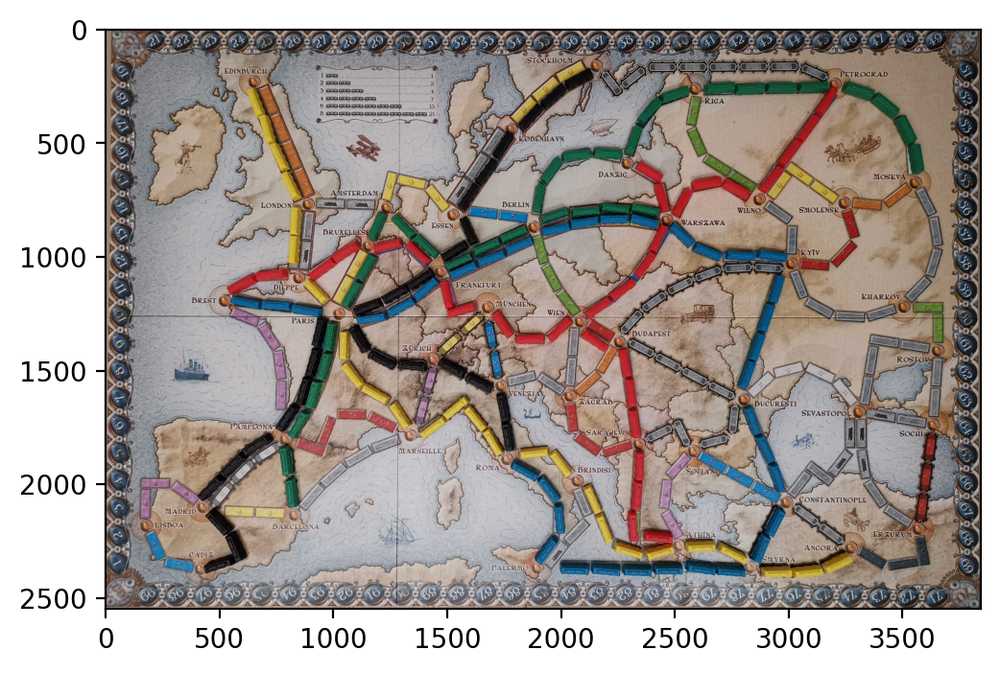

In [143]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline


import cv2 as cv
from skimage import io
from skimage.io import imread
from scipy.signal import convolve2d
from skimage.measure import label
from skimage import morphology
from sklearn.cluster import AgglomerativeClustering

#img = cv.imread("all_not_clean.jpg")
#img = cv.imread("black_blue_green.jpg")
#img = cv.imread("black_red_yellow.jpg")
img = cv.imread("all.jpg")
#img = cv.imread("red_green_blue.jpg")
#img = cv.imread("red_green_blue_inaccurate.jpg")
img = img[..., ::-1] #it' the same

plt.figure(dpi=200)
plt.imshow(img)

# Load tempalte and prepare



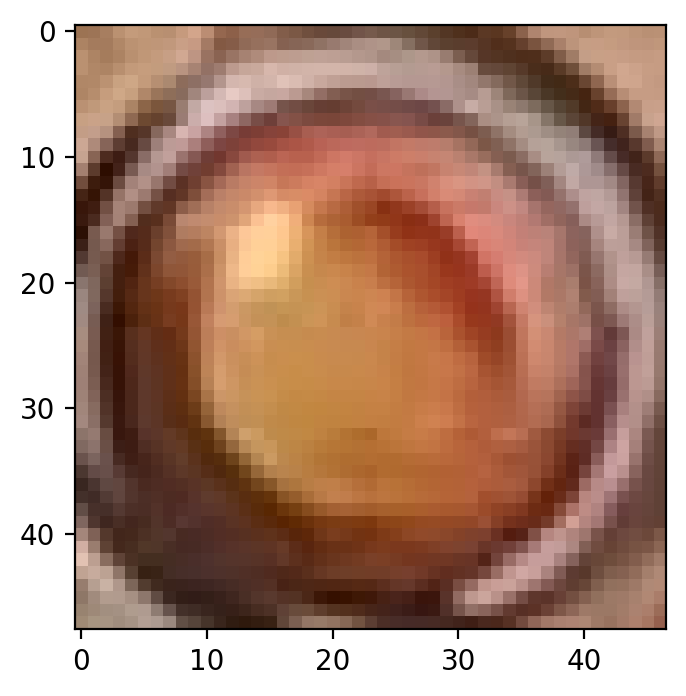

In [144]:
template = cv.imread("all.jpg")
img_template = template[..., ::-1]
template = img_template[1196:1244,1655:1702]
plt.figure(dpi=200)
plt.imshow(template)
#HLS_temp = cv.cvtColor(template, cv.COLOR_RGB2HLS)
#HUE_temp = HLS_temp[:, :, 0]              # Split attributes
#LIGHT_temp = HLS_temp[:, :, 1]
#SAT_temp = HLS_temp[:, :, 2]

# Template matching to find cities

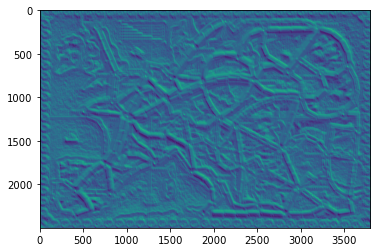

In [145]:
img2 = img.copy()
res = cv.matchTemplate(img2,template,5)
min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
plt.imshow(res)

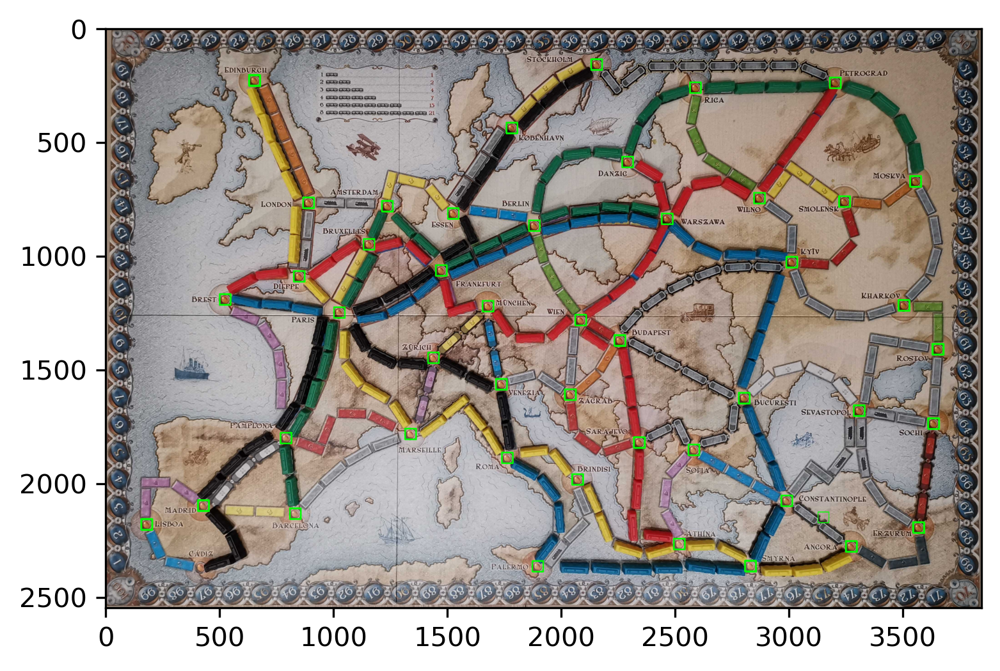

In [146]:
img_res = np.ascontiguousarray(img, dtype=np.uint8)
threshold = 0.55
w, h = template.shape[0:2]
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv.rectangle(img_res, pt, (pt[0] + w, pt[1] + h), (0,255,0), 2)
cv.imwrite('res2.png',img_res)

plt.figure(dpi=300)
plt.imshow(img_res)

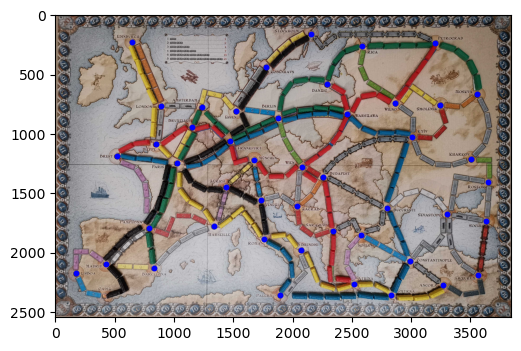

In [147]:
from sklearn.cluster import AgglomerativeClustering
loc = np.where(res >= threshold)
loc = np.stack(loc[::-1]).T
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold = 100)
clustering.fit(loc)
clusters = clustering.labels_

cit = []
#loc[clusters==1]

for i in range(clusters.max()):
    clust = loc[clusters==i]
    #print(i)
    clust_x = np.dstack((clust))[0][0]
    clust_y = np.dstack((clust))[0][1]
    #print(clust_x.mean(),clust_y.mean())
    cit.append([clust_x.mean()+20,clust_y.mean()+20])

cit = np.dstack(cit)
plt.figure(dpi=100)
plt.imshow(img)
plt.scatter(cit[:,0],cit[:,1], s=10, c="b")

# Colors trains detect



In [148]:
def rgb2ycbcr(im):
    xform = np.array([[.299, .587, .114], [-.1687, -.3313, .5], [.5, -.4187, -.0813]])
    ycbcr = im.dot(xform.T)
    ycbcr[:,:,[1,2]] += 128
    return np.uint8(ycbcr)

In [149]:
R = img[:, :, 0]              # Split attributes
G = img[:, :, 1]
B = img[:, :, 2]

HLS = cv.cvtColor(img, cv.COLOR_RGB2HLS)
HUE = HLS[:, :, 0]              # Split attributes
LIGHT = HLS[:, :, 1]
SAT = HLS[:, :, 2]

imgYCrCb = rgb2ycbcr(img)
Y = imgYCrCb[:, :, 0]              # Split attributes
Cr = imgYCrCb[:, :, 1]
Cb = imgYCrCb[:, :, 2]

img_lab = cv.cvtColor(img, cv.COLOR_BGR2Lab)
L = img_lab[:, :, 0]              # Split attributes
A = img_lab[:, :, 1]
BB = img_lab[:, :, 2]

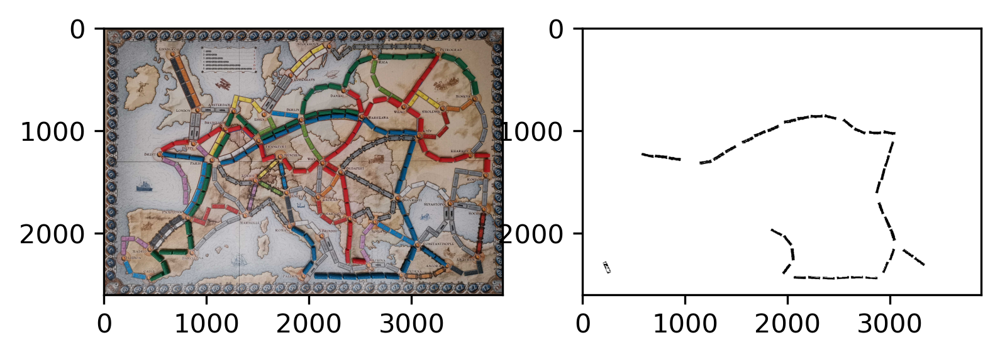

In [136]:
#blue
mask_blue =  (Cr > 167.5) | (Cr < 157) | (B > 172)
img2_blue = img.copy()
# img2[mask] = 0

mask_blue_clean = morphology.remove_small_objects(mask_blue, min_size=100, connectivity=2, in_place=False)
mask_blue_clean = morphology.remove_small_holes(mask_blue, area_threshold=2000, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_blue, cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_blue_clean, cmap="gray")

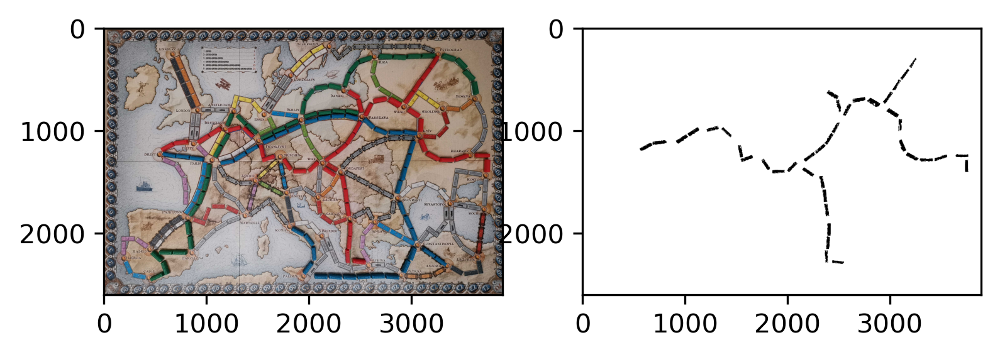

In [137]:
#red
mask_red =  (Cb > 210) | (Cb < 190) | (R < 146) | (HUE < 178) 
img2_red = img.copy()
# img2[mask] = 0

mask_red_clean = morphology.remove_small_objects(mask_red, min_size=60, connectivity=2, in_place=False)
mask_red_clean = morphology.remove_small_holes(mask_red, area_threshold=950, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_red,cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_red_clean, cmap="gray")

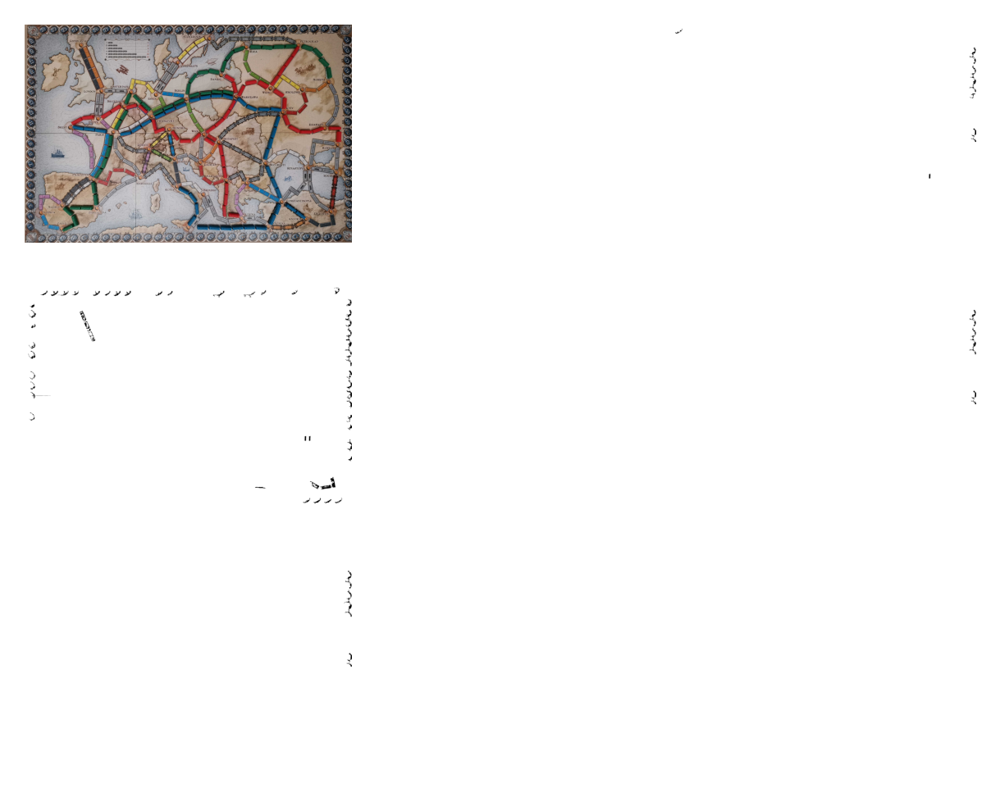

In [138]:
#black
#mask_black =(L > 0) & (L < 50) & (SAT > 0) & (SAT < 70) & (Y > 0) & (Y < 70)
mask_black =  (Cb<128)| (Cb>130)|(G>45)|(R>50)|(R<0)|(SAT>50)
mask_black2 =  (Cb<123)| (Cb>130)|(G>45)|(R>50)|(R<0)|(SAT>50)|(HUE>172)
mask_black3 =  (Cb<128)| (Cb>130)|(G>45)|(R>50)|(SAT>50)|(L > 48)|(HUE>172)
mask_black4 =  (Cb<128)| (Cb>131)|(R>50)|(SAT>52)|(L > 48)|(HUE>172)
img2_black = img.copy()
# img2[mask] = 0

mask_black_clean = morphology.remove_small_objects(mask_black, min_size=1000, connectivity=2, in_place=False)
mask_black_clean = morphology.remove_small_holes(mask_black_clean, area_threshold=800, connectivity=2, in_place=False)
mask_black_clean2 = morphology.remove_small_objects(mask_black2, min_size=1000, connectivity=2, in_place=False)
mask_black_clean2 = morphology.remove_small_holes(mask_black_clean2, area_threshold=800, connectivity=2, in_place=False)
mask_black_clean3 = morphology.remove_small_objects(mask_black3, min_size=1000, connectivity=2, in_place=False)
mask_black_clean3 = morphology.remove_small_holes(mask_black_clean3, area_threshold=900, connectivity=2, in_place=False)
mask_black_clean4 = morphology.remove_small_objects(mask_black4, min_size=1000, connectivity=2, in_place=False)
mask_black_clean4 = morphology.remove_small_holes(mask_black_clean4, area_threshold=1000, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(3,2,1)   
plt.axis('off')
plt.imshow(img2_black,cmap="gray")
plt.subplot(3,2,2)     
plt.axis('off')
plt.imshow(mask_black_clean, cmap="gray")
plt.subplot(3,2,3)     
plt.axis('off')
plt.imshow(mask_black_clean2, cmap="gray")
plt.subplot(3,2,4)     
plt.axis('off')
plt.imshow(mask_black_clean3, cmap="gray")
plt.subplot(3,2,5)     
plt.axis('off')
plt.imshow(mask_black_clean4, cmap="gray")

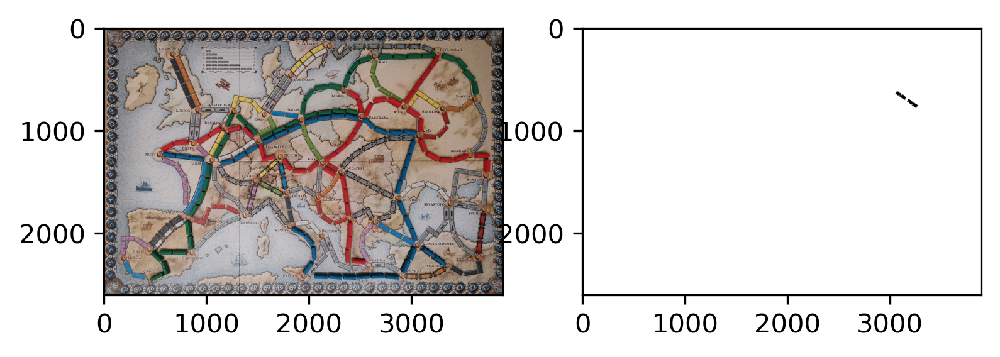

In [139]:
#yellow
mask_yellow = (HUE < 23) | (HUE > 25)|(Cr>200)|(BB < 102) | (BB > 107)
#mask_yellow = (BB < 101) | (BB > 107.5)|(Cr>80)
img2_yellow = img.copy()
# img2[mask] = 0

mask_yellow_clean = morphology.remove_small_objects(mask_yellow, min_size=400, connectivity=2, in_place=False)
mask_yellow_clean = morphology.remove_small_holes(mask_yellow, area_threshold=2500, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_yellow,cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_yellow_clean, cmap="gray")


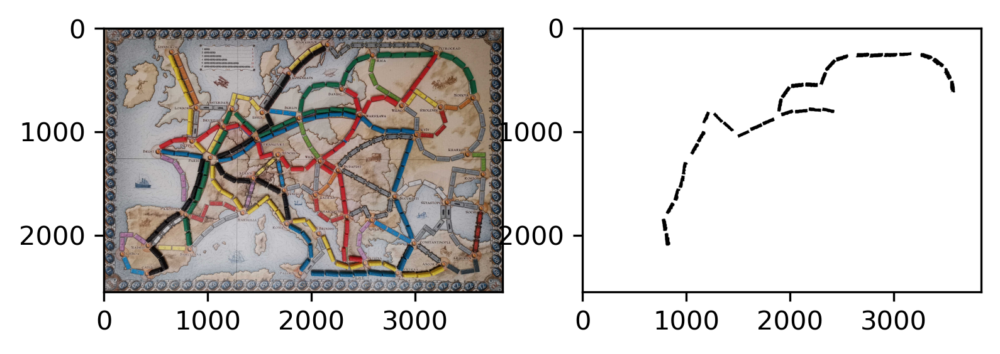

In [150]:
#green
mask_green = (HUE < 75) | (HUE > 85)|(Cb>108)
img2_green = img.copy()
# img2[mask] = 0

mask_green_clean = morphology.remove_small_objects(mask_green, min_size=30, connectivity=2, in_place=False)
mask_green_clean = morphology.remove_small_holes(mask_green, area_threshold=2000, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_green,cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_green_clean, cmap="gray")

In [126]:
def plot_cont(mask_clean):
    mask_int = mask_clean.astype(np.uint8)
    contours, hierarchy = cv.findContours(mask_int, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
    img_cnt = img.copy()
    #print(contours)
    cv.drawContours(img_cnt, contours, -1, (100,40,255), 10)
    plt.figure(dpi=150)
    plt.imshow(img_cnt)
    return contours, hierarchy 

def get_shpae(approx):
    if len(approx) == 3:
        shape = "triangle"
    elif len(approx) == 4:
#         (x, y, w, h) = cv2.boundingRect(approx)
        
        area = cv.contourArea(approx)
        perimeter = cv.arcLength(approx, True) 
        ar = area * 16 / perimeter**2
        shape = "square" if ar >= 0.95 and ar <= 1.05 else "rectangle"
    else:
        shape = "circle"
    return shape
#get_shpae(approx)

def trains_cord(contours, hierarchy):
    trains = []
    for i in range(len(contours)):
        if hierarchy[0][i][-1] != 0:
            continue
        if cv.contourArea(contours[i]) < 100:
            continue
        perimeter = cv.arcLength(contours[i], True)
        approx = cv.approxPolyDP(contours[i], 0.04 * perimeter, True)
        shape = get_shpae(approx)
        M = cv.moments(contours[i])
        cX = int((M["m10"] / M["m00"]))
        cY = int((M["m01"] / M["m00"]))
        pos = "x - " + str(cX) +", y - "+str(cY)
        if cX<(img_cnt.shape[1]-200):
            trains.append([cX,cY])
            if M["m00"] < 100:
                continue
            cv.putText(img_cnt, "*", (cX, cY), cv.FONT_HERSHEY_SIMPLEX,
                2, (255, 255, 255), 3)
    print("therea are",len(trains),"trains")
    #plt.figure(dpi=250)    
    #plt.imshow(img_cnt)
    return trains

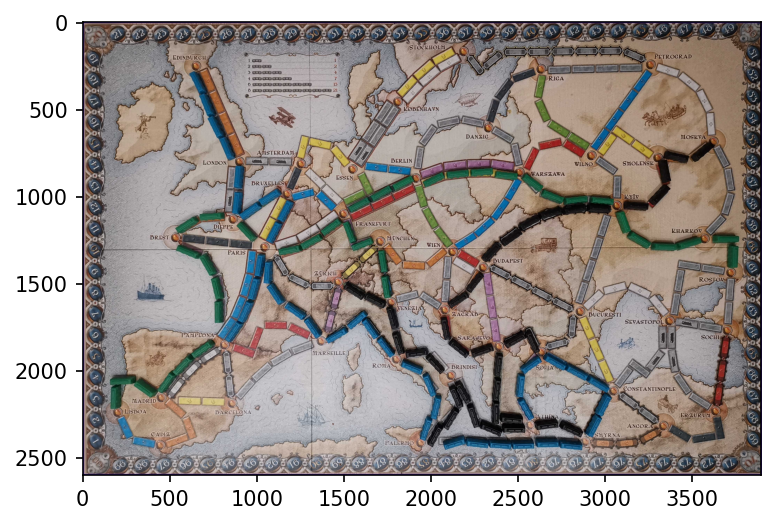

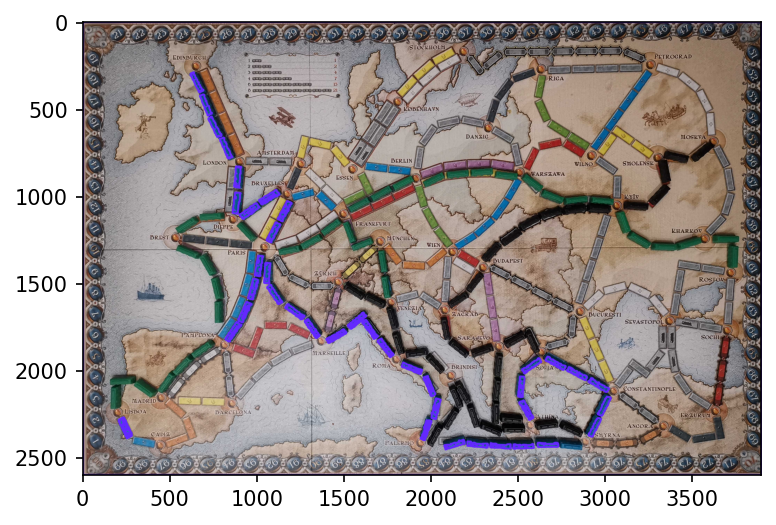

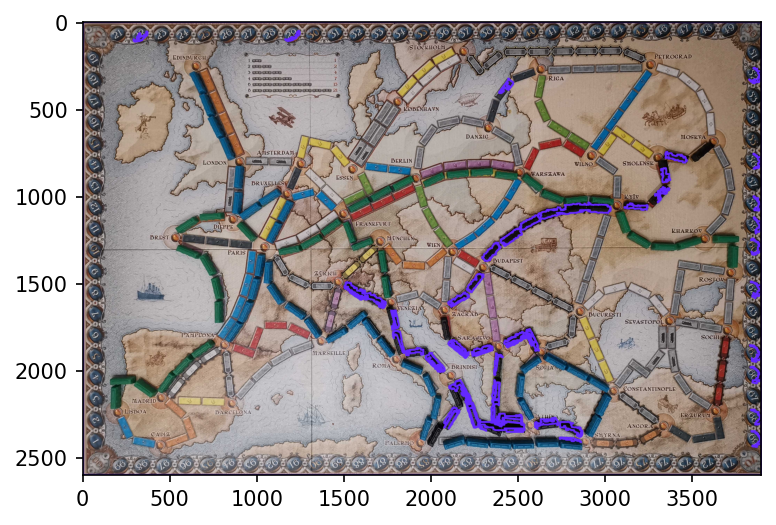

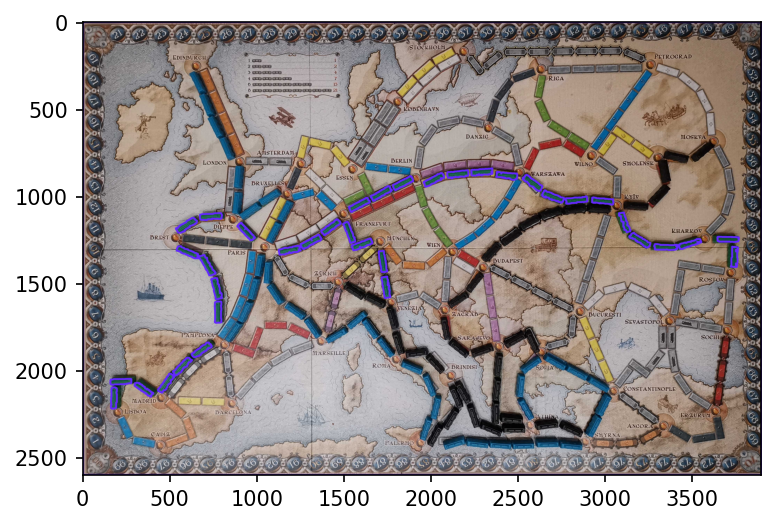

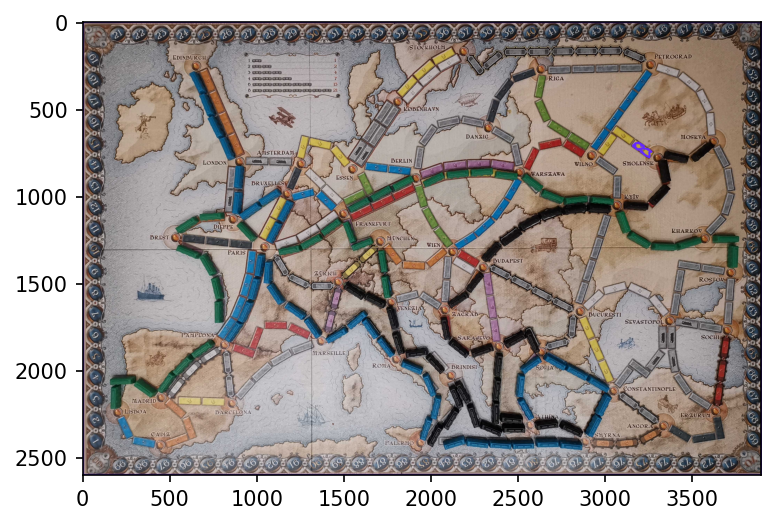

In [127]:
red_cont = plot_cont(mask_red_clean)
blue_cont = plot_cont(mask_blue_clean)
black_cont = plot_cont(mask_black_clean)
green_cont = plot_cont(mask_green_clean)
yellow_cont = plot_cont(mask_yellow_clean)

In [183]:
img_cnt = img.copy()
red_trains = trains_cord(red_cont[0],red_cont[1])
blue_trains = trains_cord(blue_cont[0],blue_cont[1])
black_trains = trains_cord(black_cont[0],black_cont[1])
green_trains = trains_cord(green_cont[0],green_cont[1])
yellow_trains = trains_cord(yellow_cont[0], yellow_cont[1])

therea are 35 trains
therea are 39 trains
therea are 3 trains
therea are 37 trains
therea are 5 trains


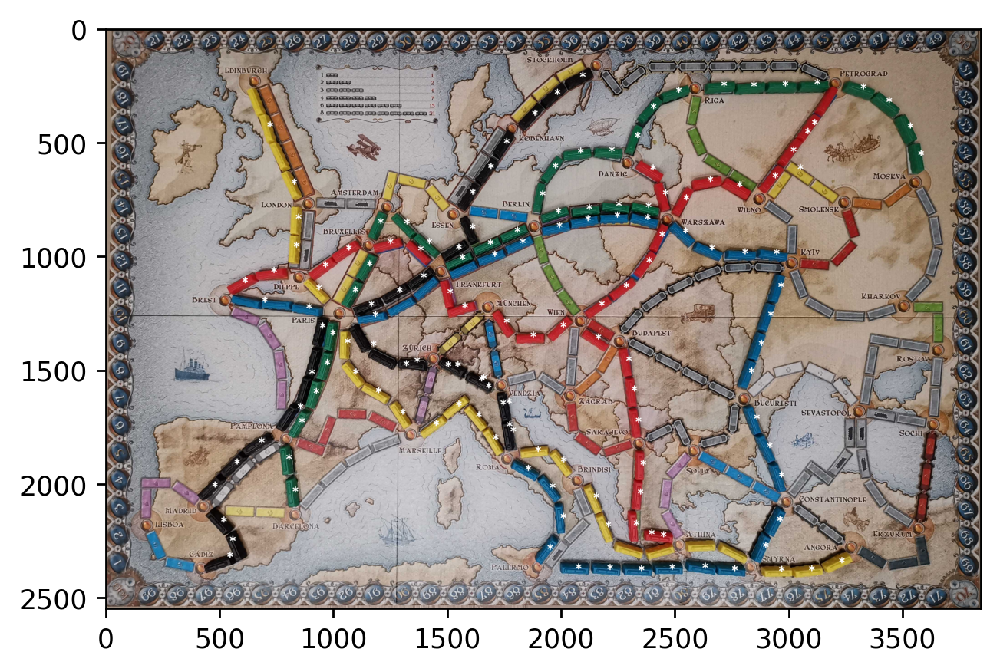

In [119]:
plt.figure(dpi=250)
plt.imshow(img_cnt)

[-1  0  1  2  3  4  5] [3 3 2 2 4 4 3]


30

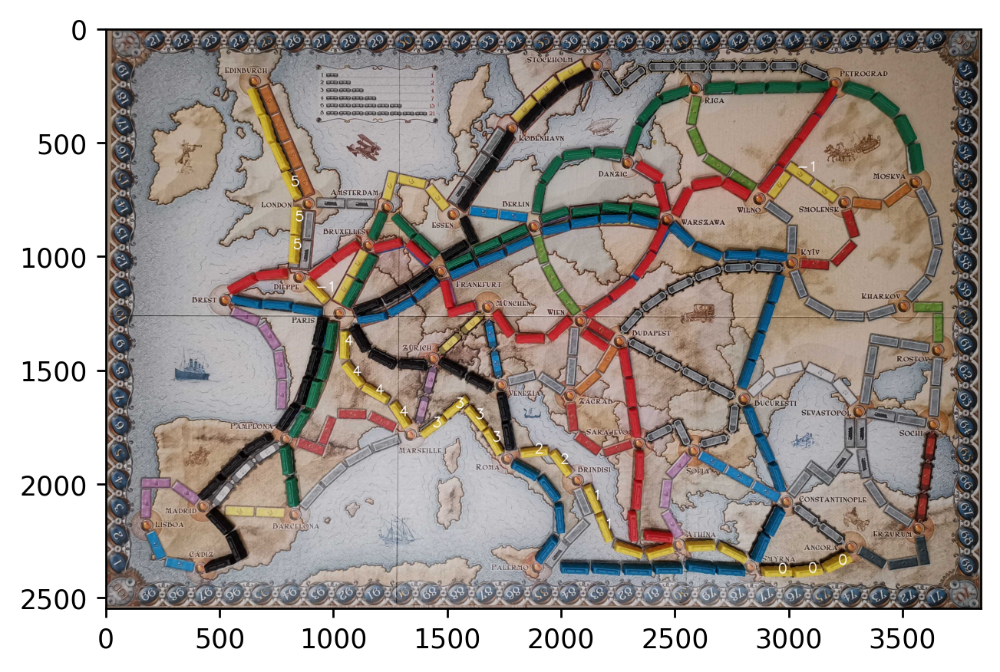

In [120]:
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS

def score(img, green_trains):
    #clustering = DBSCAN(eps=140, min_samples=2).fit(green_trains)
    #cls = clustering.labels_
    clustering = OPTICS(min_samples=2, max_eps = 160).fit(green_trains)
    cls = clustering.labels_
    
    img_cnt = img.copy()
    
    lable = 1
    lables = []
    for i in range(len(green_trains)-1):
        x = green_trains[i][0]
        y = green_trains[i][1]
        lable = cls[i]
        cv.putText(img_cnt, str(lable), (x, y), cv.FONT_HERSHEY_SIMPLEX,2, (255, 255, 255), 3)
    
    plt.figure(dpi=250)    
    plt.imshow(img_cnt)
    
    values, counts = np.unique(cls, return_counts=True)
    print(values, counts)
    counter = 0
    for i in counts:
        if i==1:
            counter +=1
        elif i==2:
            counter+=2
        elif i==3:
            counter+=4
        elif i==4:
            counter+=7
        elif i==6 or i==5 or i==7:
            counter+=15
        else:
            counter+=21
    
    return counter

score(img, yellow_trains)

[]


[]

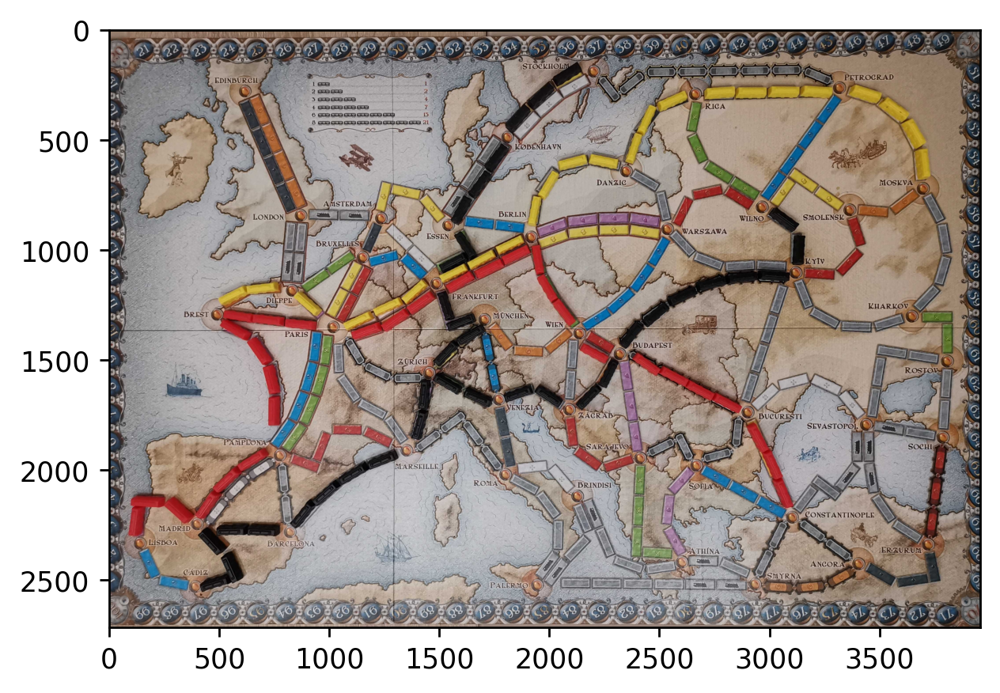

In [18]:
green_trains
img_cnt = img.copy()

lable = 1
lables = []
for i in range(len(green_trains)-1):
    print(green_trains[i][0], green_trains[i+1][0])
    x = green_trains[i][0]
    y = green_trains[i][1]
    x1 = green_trains[i+1][0]
    y1 = green_trains[i+1][1]
    xd1 = x1-x
    yd1 = y1-y
    print("d1", abs(xd1), "d2 ", abs(yd1))
    if 100<abs(xd1) and abs(yd1)<50:
        lables.append(lable)
        print("x>100, y<50")
    if 100<abs(yd1) and abs(xd1)<50:
        lables.append(lable)
        print("x<50, y>100")
    else:
        lable+=1
        lables.append(lable)
    cv.putText(img_cnt, str(lable), (x, y), cv.FONT_HERSHEY_SIMPLEX,2, (255, 255, 255), 3)

plt.figure(dpi=250)    
plt.imshow(img_cnt)      
print(lables)
green_trains

In [63]:
def trains_cord(contours):
    trains = []
    for i in range(len(contours[1])):
        if contours[2][0][i][-1] != 0:
            continue
        if cv.contourArea(contours[1][i]) < 100:
            continue
        perimeter = cv.arcLength(contours[1][i], True)
        approx = cv.approxPolyDP(contours[1][i], 0.04 * perimeter, True)
        shape = get_shpae(approx)
        M = cv.moments(contours[1][i])
        cX = int((M["m10"] / M["m00"]))
        cY = int((M["m01"] / M["m00"]))
        pos = "x - " + str(cX) +", y - "+str(cY)
        if cX<(img_cnt.shape[1]-130) and cX>130:
            trains.append([cX,cY])
            if M["m00"] < 100:
                continue
            cv.putText(img_cnt, "*", (cX, cY), cv.FONT_HERSHEY_SIMPLEX,2, (255, 255, 255), 3)
    print("therea are",len(trains),"trains")
    plt.figure(dpi=250)    
    plt.imshow(img_cnt)
    return trains

In [80]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold = 200)
clustering.fit(green_trains)
clusters = clustering.labels_

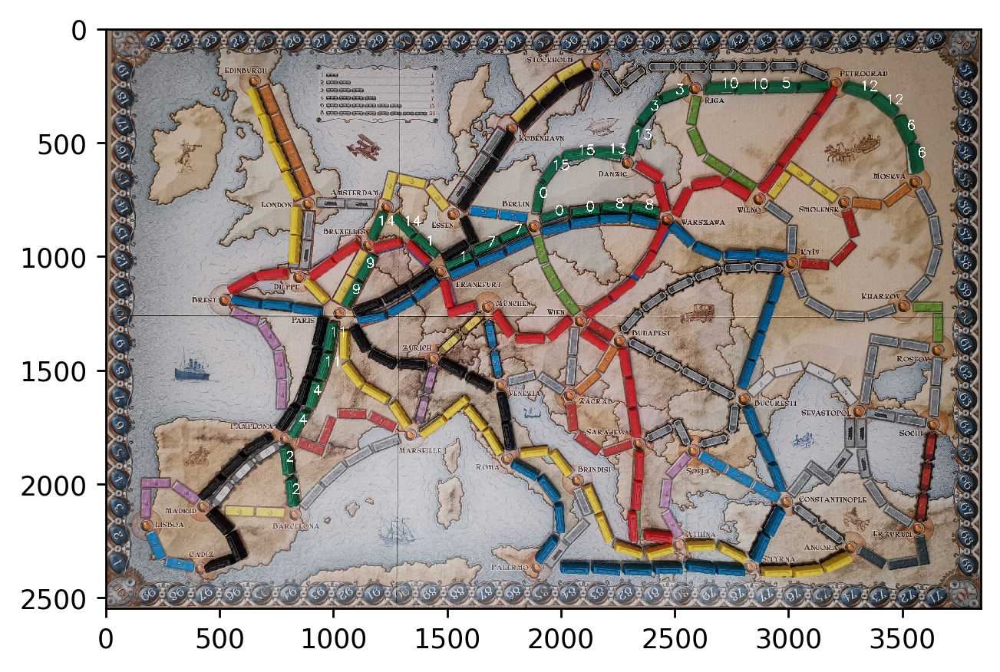

In [85]:
img_cnt = img.copy()

lable = 1
lables = []
for i in range(len(green_trains)-1):
    x = green_trains[i][0]
    y = green_trains[i][1]
    lable = clusters[i]
    cv.putText(img_cnt, str(lable), (x, y), cv.FONT_HERSHEY_SIMPLEX,2, (255, 255, 255), 3)

plt.figure(dpi=250)    
plt.imshow(img_cnt)

In [88]:
values, counts = np.unique(clusters, return_counts=True)
print(values, counts)
counter = 0
for i in counts:
    if i==1:
        counter +=1
    elif i==2:
        counter+=2
    elif i==3:
        counter+=4
    elif i==4:
        counter+=7
    elif i==6:
        counter+=15
    elif i==8:
        counter+=21

counter

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] [3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2]


34

In [90]:
from sklearn.cluster import OPTICS

clustering = OPTICS(min_samples=2).fit(green_trains)
cls = clustering.labels_


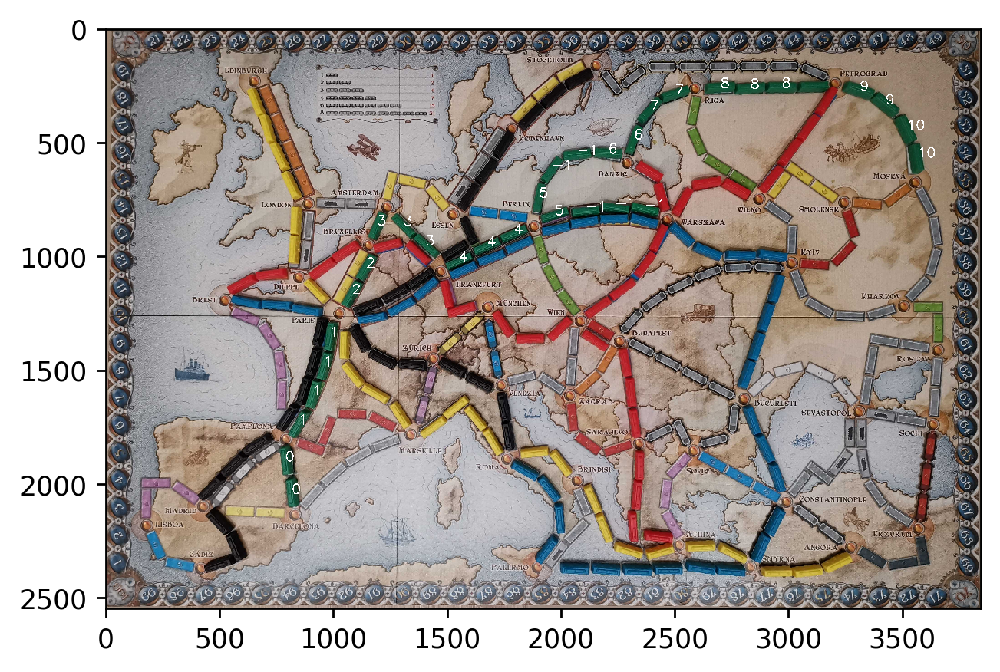

In [91]:
img_cnt = img.copy()

lable = 1
lables = []
for i in range(len(green_trains)-1):
    x = green_trains[i][0]
    y = green_trains[i][1]
    lable = cls[i]
    cv.putText(img_cnt, str(lable), (x, y), cv.FONT_HERSHEY_SIMPLEX,2, (255, 255, 255), 3)

plt.figure(dpi=250)    
plt.imshow(img_cnt)

In [92]:
values, counts = np.unique(cls, return_counts=True)
print(values, counts)
counter = 0
for i in counts:
    if i==1:
        counter +=1
    elif i==2:
        counter+=2
    elif i==3:
        counter+=4
    elif i==4:
        counter+=7
    elif i==6:
        counter+=15
    elif i==8:
        counter+=21

counter

[-1  0  1  2  3  4  5  6  7  8  9 10] [5 2 4 2 3 3 2 2 2 4 2 2]


36

[-1  0  1  2  3  4  5] [3 3 3 2 5 4 4]


43

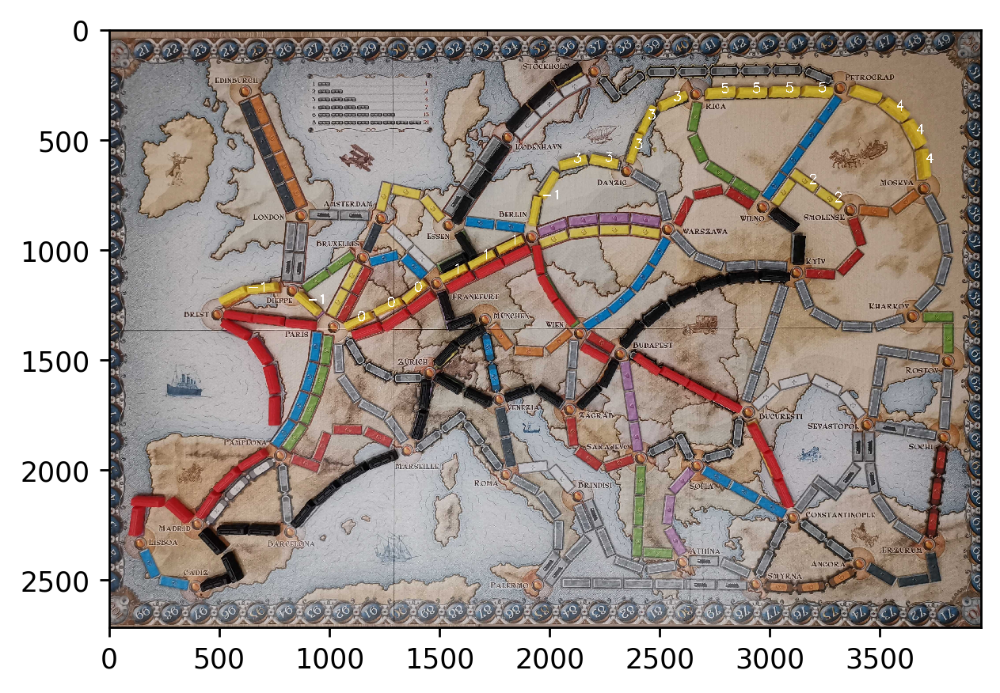

[-1  0  1  2  3  4  5  6  7] [12  2  3  2  3  2  2  2  4]


46

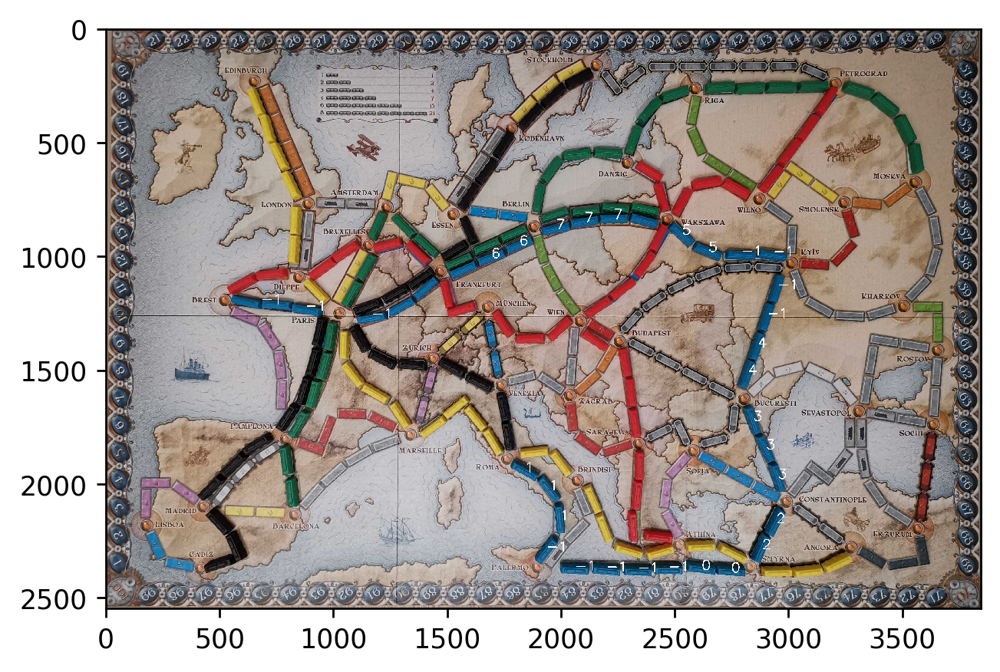

In [142]:
score(img, blue_trains)

[-1  0  1  2  3  4  5] [4 3 2 4 4 3 2]


33

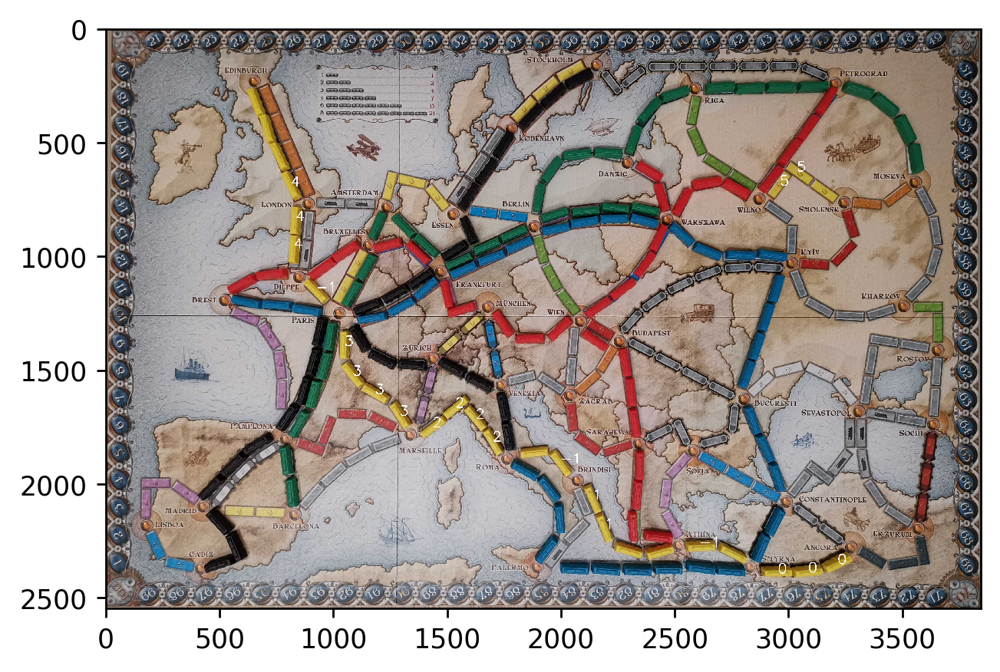

In [143]:
score(img, yellow_trains)

[-1  0  1  2  3  4  5  6  7  8  9 10 11] [2 2 2 3 3 3 2 2 2 2 2 3 4]


39

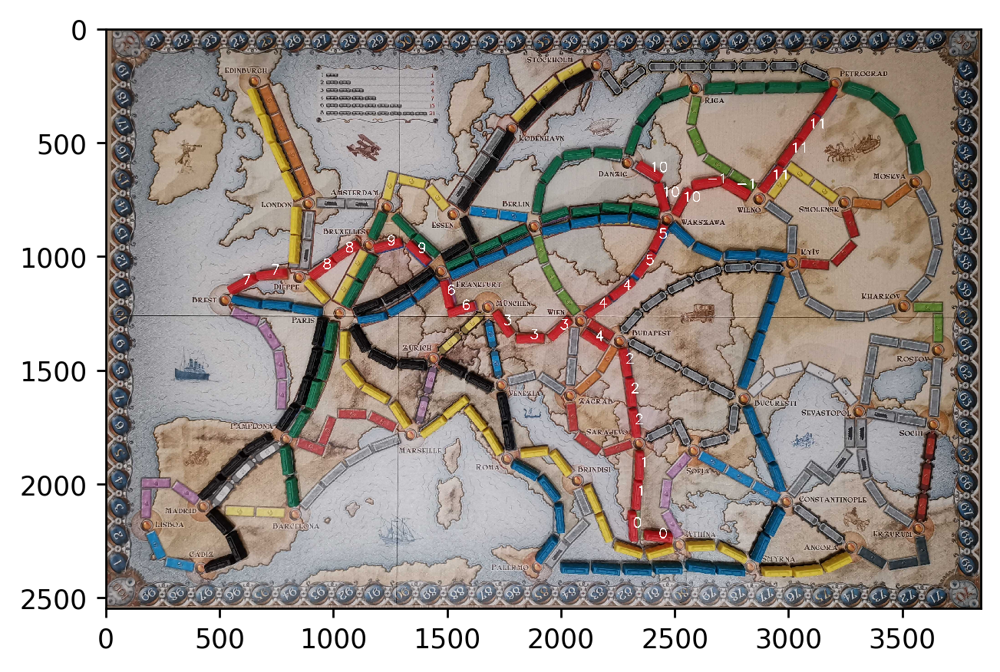

In [144]:
score(img, red_trains)

[-1  0  1  2  3  4  5  6] [5 2 4 4 3 3 3 3]


47

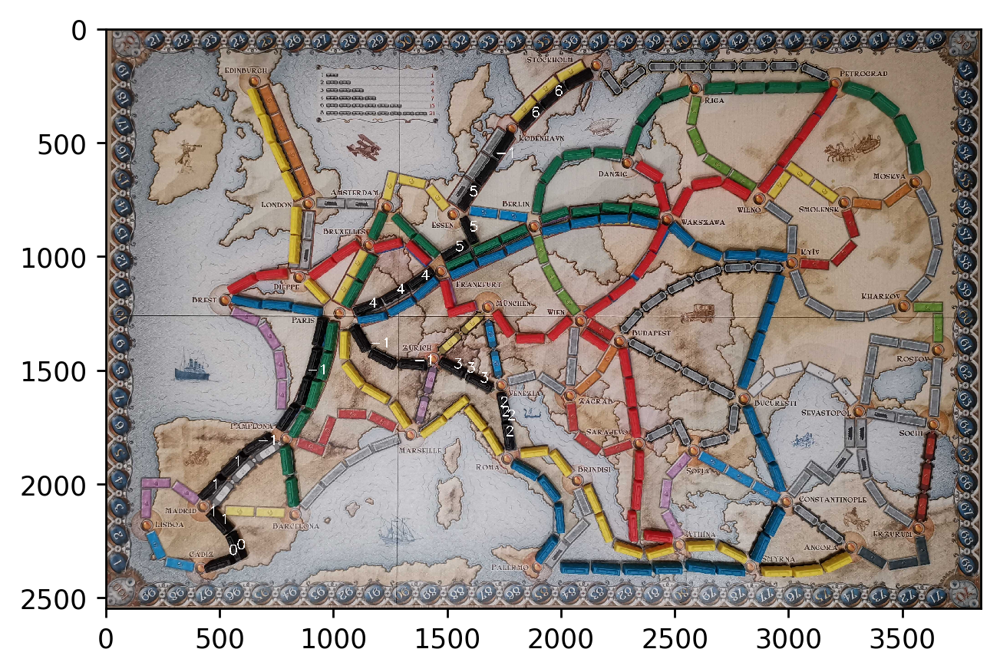

In [145]:
score(img, black_trains)